In [3]:
import yaml
import os

In [11]:
with open(os.path.expanduser('~/develop/ClearML_ML_SD.yml'), 'r') as f:
    keys = yaml.safe_load(f)

In [14]:
os.environ["CLEARML_WEB_HOST"] = "https://app.clear.ml"
os.environ["CLEARML_API_HOST"] = "https://api.clear.ml"
os.environ["CLEARML_FILES_HOST"] = "https://files.clear.ml"
os.environ["CLEARML_API_ACCESS_KEY"] = keys['access_key']
os.environ["CLEARML_API_SECRET_KEY"] = keys['secret_key']

In [15]:
from clearml import Task, Logger

In [16]:
task = Task.init(
    project_name='ML_SD', 
    task_name='EDA & split data', 
    tags=['eda', 'split_data'])

ClearML Task: created new task id=d59b791faff142689f5343b7a1cf009f
2022-10-25 00:28:47,214 - clearml.Repository Detection - WARNING - Failed accessing the jupyter server(s): []
2022-10-25 00:28:47,242 - clearml.Task - INFO - No repository found, storing script code instead
ClearML results page: https://app.clear.ml/projects/922c69dbd48249b183708fef50f18e10/experiments/d59b791faff142689f5343b7a1cf009f/output/log
ClearML Monitor: Could not detect iteration reporting, falling back to iterations as seconds-from-start


In [ ]:
# task id=d59b791faff142689f5343b7a1cf009f

In [33]:
import pandas as pd
import numpy as np
import json
import re
import os
from tqdm.notebook import tqdm
from pymorphy2 import MorphAnalyzer
from functools import partial
from matplotlib import pyplot as plt
from wordcloud import WordCloud
from matplotlib import pyplot as plt
from collections import Counter
from stop_words import get_stop_words

tqdm.pandas()



In [18]:
SEED = 21
PATH = '../data'

In [19]:
df = pd.read_csv(os.path.join(PATH, 'RuMedPrimeData.zip'), sep='\t', compression='zip')

In [20]:
df.shape

(7625, 6)

In [21]:
df['icd10'].value_counts()

I11.9    354
E06.3    210
G54.4    202
M54.2    177
M54.8    160
        ... 
N95.0      1
L22        1
M21        1
L50.6      1
M42        1
Name: icd10, Length: 992, dtype: int64

In [22]:
df['level_2'] = df['icd10'].str.split('.').apply(lambda x: x[0])
df['level_1'] = df['icd10'].apply(lambda x: x[0])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


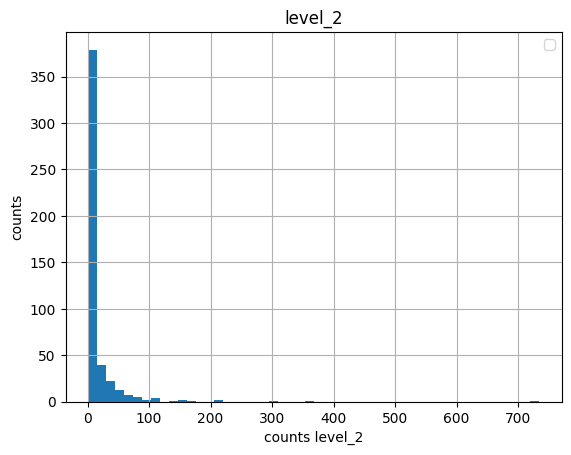

In [37]:
ax = df['level_2'].value_counts().hist(bins=50)
ax.set_xlabel('counts level_2')
ax.set_ylabel('counts')
ax.set_title('level_2')
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


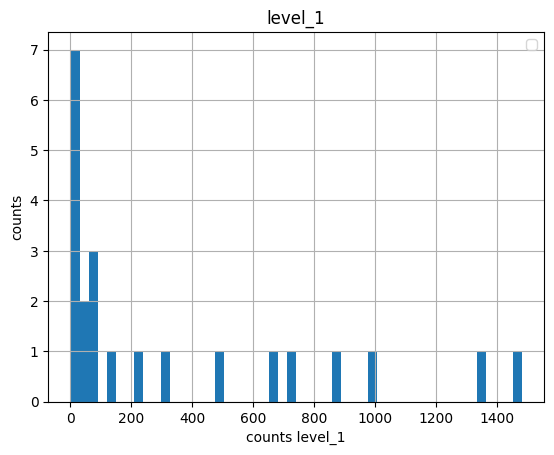

In [38]:
ax = df['level_1'].value_counts().hist(bins=50)
ax.set_xlabel('counts level_1')
ax.set_ylabel('counts')
ax.set_title('level_1')
plt.show()

In [31]:
ttt = df \
    .groupby('level_1')['level_2'] \
    .value_counts() \
    .to_frame('cnt') \
    .reset_index()

for level_1, subset in ttt.groupby('level_1'):
    display(subset)

,level_1,level_2,cnt
0,A,A09,5
1,A,A04,2
2,A,A37,1
3,A,A69,1
4,A,A84,1


,level_1,level_2,cnt
5,B,B66,15
6,B,B35,13
7,B,B36,10
8,B,B02,9
9,B,B00,6
10,B,B07,5
11,B,B18,4
12,B,B27,4
13,B,B97,4
14,B,B37,2


,level_1,level_2,cnt
17,C,C71,4
18,C,C00,1
19,C,C06,1
20,C,C20,1
21,C,C25,1
22,C,C34,1
23,C,C50,1
24,C,C53,1
25,C,C73,1


,level_1,level_2,cnt
26,D,D25,76
27,D,D50,41
28,D,D23,19
29,D,D21,9
30,D,D17,8
31,D,D27,8
32,D,D86,5
33,D,D33,4
34,D,D80,4
35,D,D84,4


,level_1,level_2,cnt
55,E,E06,220
56,E,E66,136
57,E,E04,95
58,E,E11,70
59,E,E01,65
60,E,E05,58
61,E,E89,34
62,E,E03,29
63,E,E22,28
64,E,E28,24


,level_1,level_2,cnt
87,F,F41,16
88,F,F45,6
89,F,F43,2
90,F,F48,2
91,F,F51,2
92,F,F38,1
93,F,F40,1
94,F,F42,1
95,F,F84,1
96,F,F95,1


,level_1,level_2,cnt
98,G,G54,304
99,G,G90,215
100,G,G44,171
101,G,G20,151
102,G,G40,85
103,G,G52,55
104,G,G98,48
105,G,G25,39
106,G,G43,38
107,G,G62,32


,level_1,level_2,cnt
142,H,H81,37
143,H,H65,15
144,H,H10,13
145,H,H52,12
146,H,H90,8
147,H,H35,7
148,H,H61,6
149,H,H60,5
150,H,H66,4
151,H,H83,4


,level_1,level_2,cnt
163,I,I11,360
164,I,I67,67
165,I,I10,56
166,I,I20,39
167,I,I49,33
168,I,I83,31
169,I,I25,14
170,I,I70,8
171,I,I86,7
172,I,I88,7


,level_1,level_2,cnt
198,J,J06,162
199,J,J30,81
200,J,J45,65
201,J,J00,55
202,J,J35,44
203,J,J18,43
204,J,J31,38
205,J,J42,35
206,J,J84,32
207,J,J01,30


,level_1,level_2,cnt
225,K,K29,107
226,K,K81,75
227,K,K21,72
228,K,K80,38
229,K,K58,34
230,K,K26,23
231,K,K52,15
232,K,K64,15
233,K,K40,11
234,K,K83,11


,level_1,level_2,cnt
261,L,L30,54
262,L,L40,34
263,L,L20,32
264,L,L21,30
265,L,L70,27
266,L,L71,17
267,L,L23,14
268,L,L50,13
269,L,L60,12
270,L,L64,9


,level_1,level_2,cnt
300,M,M54,734
301,M,M13,116
302,M,M19,90
303,M,M02,58
304,M,M17,50
305,M,M53,48
306,M,M75,43
307,M,M51,37
308,M,M05,30
309,M,M77,30


,level_1,level_2,cnt
351,N,N76,112
352,N,N41,108
353,N,N20,78
354,N,N30,70
355,N,N95,65
356,N,N83,52
357,N,N80,50
358,N,N97,45
359,N,N40,42
360,N,N86,39


,level_1,level_2,cnt
399,O,O20,6
400,O,O24,3
401,O,O21,2
402,O,O26,2
403,O,O00,1
404,O,O99,1


,level_1,level_2,cnt
405,P,P91,1


,level_1,level_2,cnt
406,Q,Q28,2
407,Q,Q23,1
408,Q,Q24,1
409,Q,Q51,1
410,Q,Q52,1
411,Q,Q60,1


,level_1,level_2,cnt
412,R,R50,12
413,R,R55,8
414,R,R56,8
415,R,R79,8
416,R,R09,6
417,R,R00,5
418,R,R10,5
419,R,R32,5
420,R,R51,5
421,R,R43,2


,level_1,level_2,cnt
439,S,S80,6
440,S,S92,4
441,S,S50,3
442,S,S61,3
443,S,S83,3
444,S,S93,3
445,S,S20,2
446,S,S89,2
447,S,S22,1
448,S,S30,1


,level_1,level_2,cnt
456,T,T22,2
457,T,T06,1
458,T,T14,1
459,T,T24,1
460,T,T26,1
461,T,T34,1
462,T,T78,1
463,T,T79,1


,level_1,level_2,cnt
464,U,U07,1


,level_1,level_2,cnt
465,Z,Z00,20
466,Z,Z31,11
467,Z,Z01,9
468,Z,Z03,6
469,Z,Z33,5
470,Z,Z71,4
471,Z,Z96,4
472,Z,Z04,3
473,Z,Z02,2
474,Z,Z30,2


In [32]:
ttt.groupby('level_1')['cnt'].agg(list).values

array([list([5, 2, 1, 1, 1]),
       list([15, 13, 10, 9, 6, 5, 4, 4, 4, 2, 1, 1]),
       list([4, 1, 1, 1, 1, 1, 1, 1, 1]),
       list([76, 41, 19, 9, 8, 8, 5, 4, 4, 4, 3, 3, 3, 3, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
       list([220, 136, 95, 70, 65, 58, 34, 29, 28, 24, 18, 14, 12, 10, 9, 8, 7, 7, 7, 6, 5, 5, 4, 4, 4, 2, 2, 1, 1, 1, 1, 1]),
       list([16, 6, 2, 2, 2, 1, 1, 1, 1, 1, 1]),
       list([304, 215, 171, 151, 85, 55, 48, 39, 38, 32, 21, 20, 20, 19, 17, 16, 9, 8, 7, 6, 6, 6, 5, 5, 5, 5, 4, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1]),
       list([37, 15, 13, 12, 8, 7, 6, 5, 4, 4, 3, 3, 2, 2, 2, 1, 1, 1, 1, 1, 1]),
       list([360, 67, 56, 39, 33, 31, 14, 8, 7, 7, 6, 6, 5, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
       list([162, 81, 65, 55, 44, 43, 38, 35, 32, 30, 24, 23, 20, 18, 17, 14, 8, 8, 7, 5, 3, 2, 2, 1, 1, 1, 1]),
       list([107, 75, 72, 38, 34, 23, 15, 15, 11, 11, 10, 9, 8, 7, 7, 6, 6, 5, 5, 4, 4, 3, 3, 2, 2, 2, 

In [34]:
def norm_form(list_words, morph):
    return [morph.parse(word)[0].normal_form for word in list_words]

def del_stopwords(list_words, stop_words):
    return [word for word in list_words if word not in stop_words]

In [35]:
df['symptoms_tokens'] = df['symptoms'] \
    .str.lower() \
    .str.split('[^a-zа-яё]+') \
    .progress_apply(partial(norm_form, morph=MorphAnalyzer())) \
    .progress_apply(partial(del_stopwords, stop_words=get_stop_words('russian')))

  0%|          | 0/7625 [00:00<?, ?it/s]

  0%|          | 0/7625 [00:00<?, ?it/s]

In [36]:
df.head()

,symptoms,anamnesis,icd10,new_patient_id,new_event_id,new_event_time,level_2,level_1,symptoms_tokens
0,"Сухость кожи, мышечная слабость, нарушение мен...",Месяц назад сильный стресс и на этом фоне появ...,E01.8,qf156c36,q5fc2cb1,2027-05-19,E01,E,"[сухость, кожа, мышечный, слабость, нарушение,..."
1,"Жалобы ГБ: головная боль, головокружение на фо...","Начало острое, постепенное, после переохлажден...",J06.9,q9321cf8,qe173f20,2023-03-24,J06,J,"[жалоба, гб, головной, боль, головокружение, ф..."
2,"головная боль, озноб, насморк, легкая заложенн...","Начало острое, *ДАТА* после переохлаждения. Пр...",J00,qcbc06c5,q653efaa,2026-12-22,J00,J,"[головной, боль, озноб, насморк, лёгкий, залож..."
3,"На изжога периодически , отрыжка воздухом, . б...",Впервые пояились вышеизложенные жалобы в течен...,K21.0,qfd53b1f,qe48681b,2026-01-15,K21,K,"[изжога, периодически, отрыжка, воздух, боль, ..."
4,"- лабильность настроения, плаксивость.","Тиреоидэктомия в*ДАТА* по поводу МУЗ, по гисто...",E89.0,q783a54b,q4109cab,2021-05-28,E89,E,"[, лабильность, настроение, плаксивость, ]"


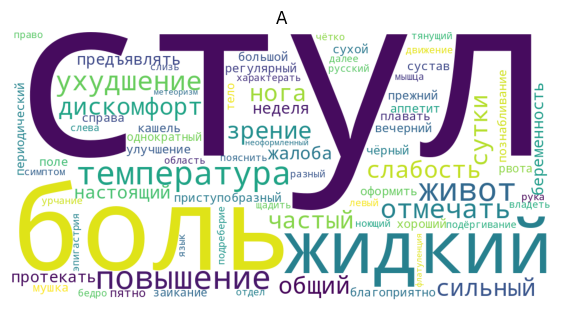

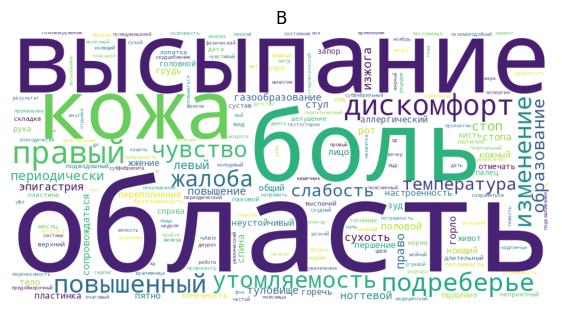

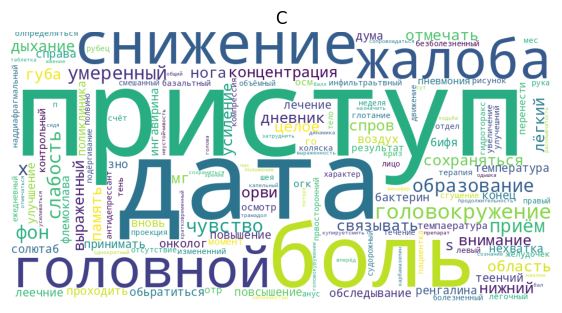

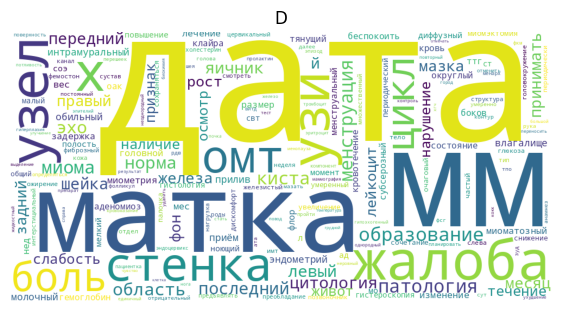

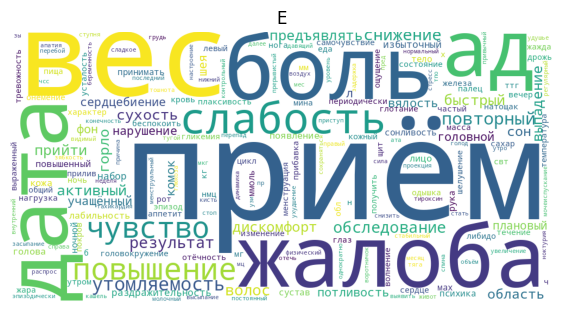

...

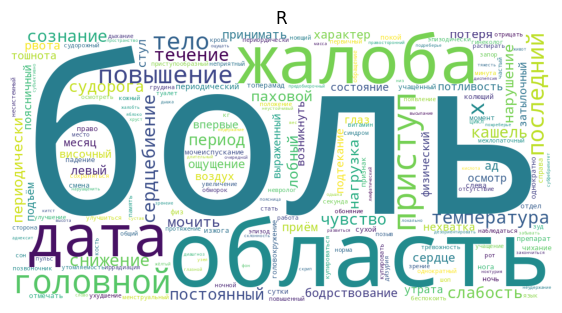

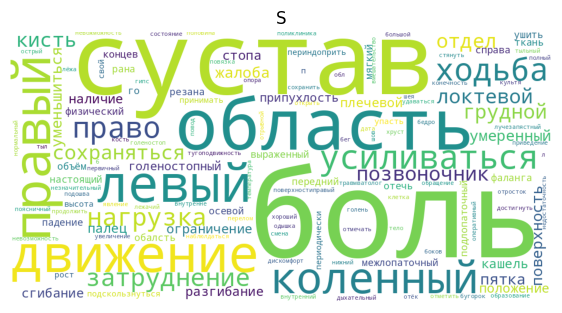

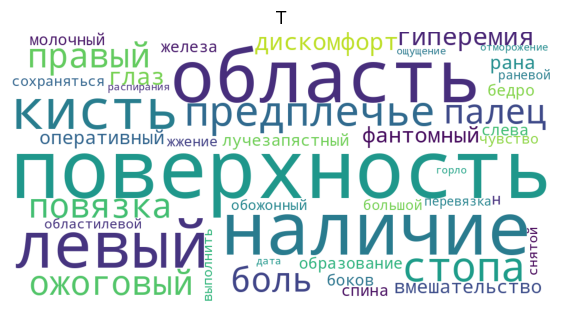

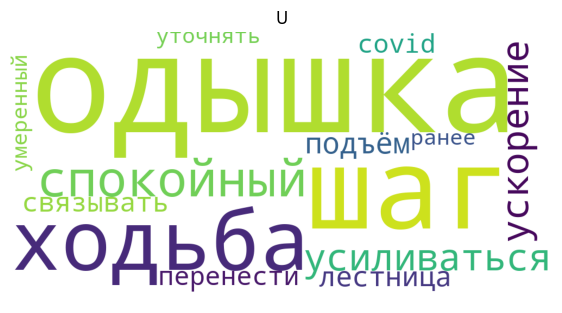

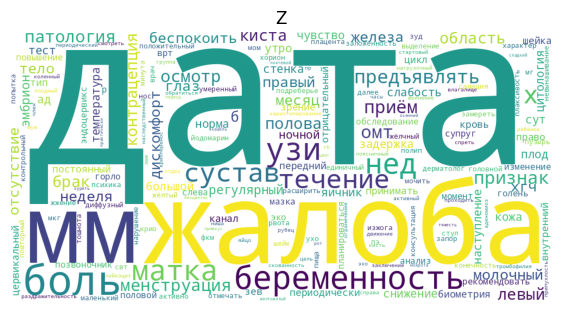

In [39]:
wordcloud = WordCloud(
    width = 1000, 
    height = 500,
    background_color="white",
)

for label, list_words in df.groupby('level_1')['symptoms_tokens'].sum().items():
    fig, ax = plt.subplots(figsize=(7,4))
    ax.set_title(label)
    ax.imshow(wordcloud.generate_from_frequencies(Counter(list_words)))
    ax.axis("off")
    plt.show()

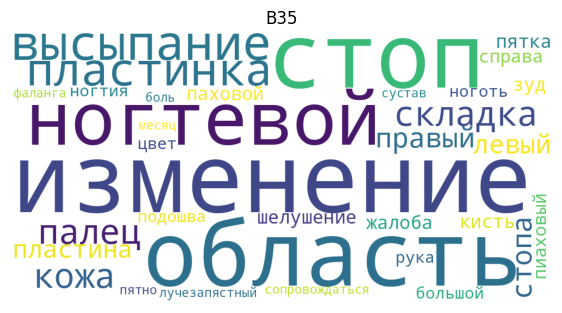

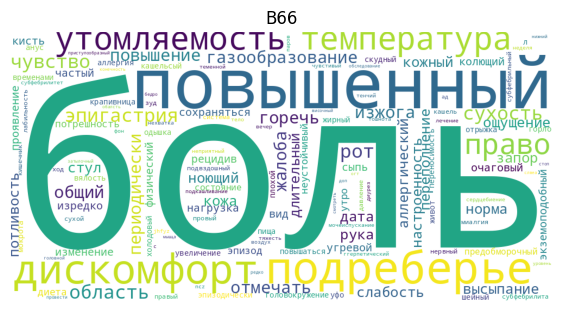

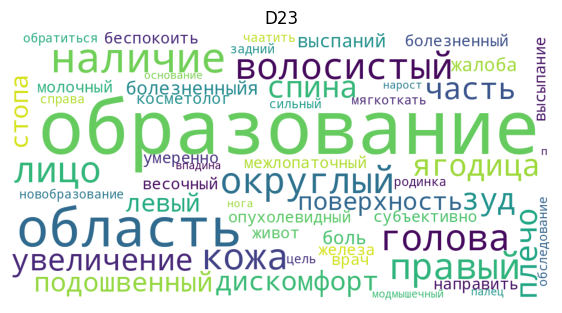

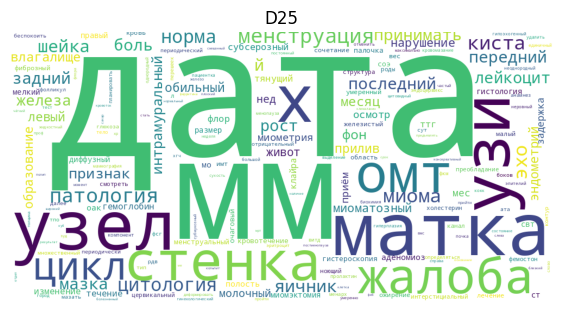

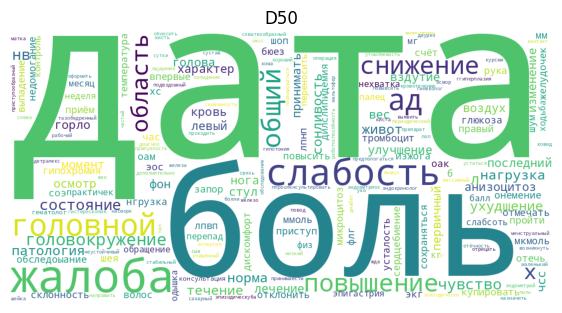

...

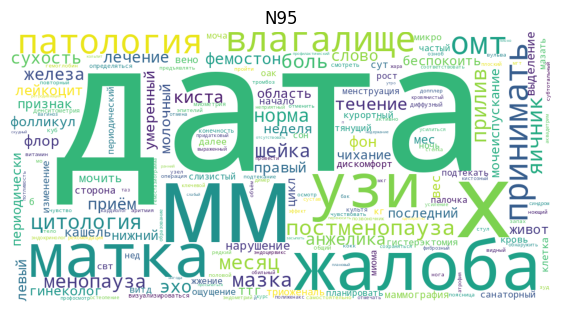

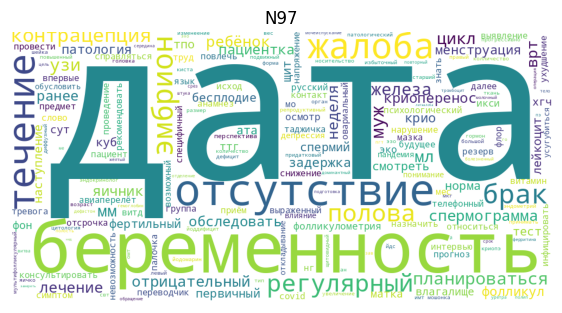

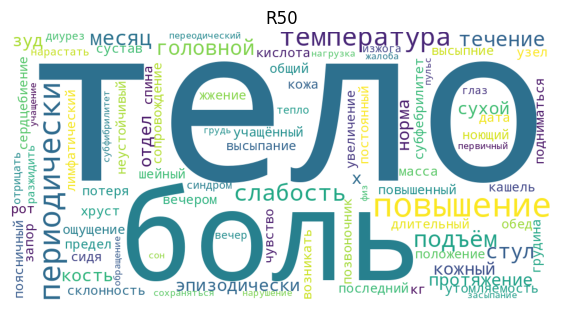

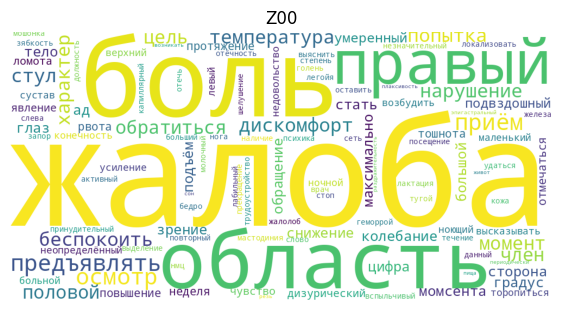

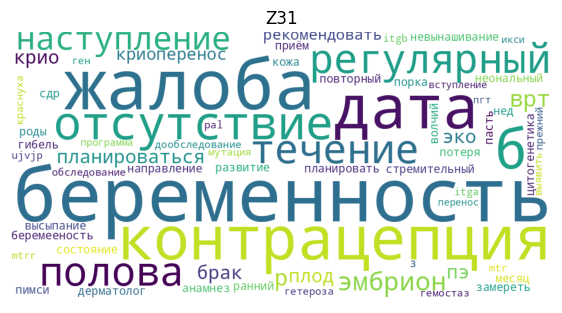

In [40]:
mask = df.groupby('level_2').transform('size') > 10
for label, list_words in df[mask].groupby('level_2')['symptoms_tokens'].sum().items():
    fig, ax = plt.subplots(figsize=(7,4))
    ax.set_title(label)
    ax.imshow(wordcloud.generate_from_frequencies(Counter(list_words)))
    ax.axis("off")
    plt.show()

# split data

In [46]:
df_all = pd.read_csv(os.path.join(PATH, 'RuMedPrimeData.zip'), sep='\t', compression='zip')

df_train, df_val, df_test = np.split(
    df_all.sample(frac=1, random_state=SEED), 
    [int(0.735*len(df)), int(0.8675*len(df))]
)
df_train.to_csv(os.path.join(PATH, 'train.csv'))
df_val.to_csv(os.path.join(PATH, 'val.csv'))
df_test.to_csv(os.path.join(PATH, 'test.csv'))